<a href="https://colab.research.google.com/github/omsharma-001/Motion_Planning_In_Multi_Robotic_System/blob/main/drl.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, obstacles, start_positions):
        self.size = size
        self.static_obstacles = obstacles
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        if not (0 <= row < self.size and 0 <= col < self.size):
            return False
        if (row, col) in self.static_obstacles:
            return False
        if position in blocked_cells:
            return False
        return True

    def get_adjacent_cells(self, position):
        # Returns the adjacent cells (up, down, left, right)
        adjacent = []
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]  # Up, Down, Left, Right
        for dr, dc in directions:
            r, c = row + dr, col + dc
            if 0 <= r < self.size and 0 <= c < self.size:
                adjacent.append((r, c))
        return adjacent

    def step(self, actions):
        # Initialize blocked cells with static obstacles
        blocked_cells = set(self.static_obstacles)
        # Copy of current positions to check conflicts
        new_positions = self.robot_positions.copy()
        # Robot movement priorities (you can adjust this as needed)
        robot_priorities = list(range(self.num_robots))
        # Each robot plans its move
        intended_positions = [None] * self.num_robots
        for i in robot_priorities:
            action = actions[i]
            row, col = self.robot_positions[i]
            if action == 0:  # Up
                next_pos = (row - 1, col)
            elif action == 1:  # Down
                next_pos = (row + 1, col)
            elif action == 2:  # Left
                next_pos = (row, col - 1)
            elif action == 3:  # Right
                next_pos = (row, col + 1)
            elif action == 4:  # Stay in place
                next_pos = (row, col)
            else:
                next_pos = (row, col)  # Default to stay in place
            intended_positions[i] = next_pos

        # Before robots move, collect intended positions and their adjacent cells for each robot
        future_blocked_cells = {}
        for idx, pos in enumerate(intended_positions):
            cells = set()
            cells.add(pos)
            cells.update(self.get_adjacent_cells(pos))
            future_blocked_cells[idx] = cells

        # Each robot moves in order of priority
        for i in robot_priorities:
            # For the current robot, exclude its own intended position and adjacent cells
            other_future_blocked_cells = set()
            for idx in range(self.num_robots):
                if idx != i:
                    other_future_blocked_cells.update(future_blocked_cells[idx])

            current_blocked_cells = blocked_cells.union(other_future_blocked_cells)
            current_blocked_cells.discard(self.robot_positions[i])  # Allow staying in place

            next_pos = intended_positions[i]
            # Check if move is valid and does not result in being adjacent to other robots
            if self.is_valid_move(next_pos, current_blocked_cells):
                # Move robot
                new_positions[i] = next_pos
                # Update blocked cells
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                # Robot stays in place
                new_positions[i] = self.robot_positions[i]
                # Block current position and adjacent cells
                blocked_cells.add(self.robot_positions[i])
                blocked_cells.update(self.get_adjacent_cells(self.robot_positions[i]))

        # Update positions
        self.robot_positions = new_positions.copy()

        # Compute rewards and dones
        rewards = []
        dones = []
        for i in range(self.num_robots):
            if self.robot_positions[i] == self.goals[i]:
                rewards.append(10.0)
                dones.append(True)
            else:
                rewards.append(-0.1)  # Penalty for each step
                dones.append(False)

        return self.robot_positions.copy(), rewards, dones

    def print_grid(self):
        grid = [['O' for _ in range(self.size)] for _ in range(self.size)]
        for obs in self.static_obstacles:
            row, col = obs
            grid[row][col] = 'X'
        for i, goal in enumerate(self.goals):
            row, col = goal
            grid[row][col] = 'G' + str(i)
        for i, pos in enumerate(self.robot_positions):
            row, col = pos
            grid[row][col] = 'R' + str(i)
        for row in grid:
            print(' '.join(row))

def q_learning_multi_robot(env, q_tables, episodes=2000, gamma=0.95, alpha=0.1, epsilon=0.1):
    action_size = 5  # Number of actions (up, down, left, right, stay)
    num_robots = env.num_robots

    for e in range(episodes):
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * num_robots

        step_counter = 0
        max_steps = 100  # Define a maximum number of steps per episode

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i in range(num_robots):
                state = states[i]
                if dones[i]:
                    actions.append(4)  # Stay in place
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    # Exploration
                    action = np.random.choice(action_size)
                else:
                    # Exploitation
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            # Take a step in the environment
            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            # Update Q-tables for each robot
            for i in range(num_robots):
                if dones[i]:
                    continue  # No need to update if the robot has reached its goal
                state = states[i]
                next_state = next_states[i]
                action = actions[i]
                reward = rewards[i]

                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)

                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        # Optionally, print progress every 100 episodes
        if (e + 1) % 100 == 0:
            print(f"Episode {e+1} finished in {step_counter} steps.")

    # After training, run one final greedy episode to find the optimal paths
    states = env.reset()
    states = [tuple(state) for state in states]
    dones = [False] * num_robots
    final_steps = [[] for _ in range(num_robots)]
    final_paths = [[list(state)] for state in states]

    step_counter = 0
    max_steps = 100

    while not all(dones) and step_counter < max_steps:
        actions = []
        for i in range(num_robots):
            state = states[i]
            if dones[i]:
                actions.append(4)  # Stay in place
                continue
            if state not in q_tables[i]:
                action = 4  # Stay in place if state unseen
            else:
                action = np.argmax(q_tables[i][state])  # Choose the best action based on the Q-values
            actions.append(action)
            final_steps[i].append(action)

        next_states, rewards, dones = env.step(actions)
        next_states = [tuple(state) for state in next_states]

        for i in range(num_robots):
            if not dones[i]:
                final_paths[i].append(list(next_states[i]))

        states = next_states
        step_counter += 1

    # Print final paths and steps
    for i in range(num_robots):
        print(f"Robot {i} steps taken to reach the destination: {final_steps[i]}")
        print(f"Robot {i} final path from source to destination: {final_paths[i]}")

    # Print final grid
    print("Final grid with robots' positions:")
    env.print_grid()

# Define the environment with grid size 4x4
size = 4
# No static obstacles for simplicity
obstacles = []

# Define starting positions for each robot
start_positions = [(0, 0), (3, 0)]
num_robots = len(start_positions)

# Define goals for each robot
goals = [(3, 3), (0, 3)]  # Robot 0 aims for (3,3), Robot 1 aims for (0,3)

# Create the environment
env = MultiRobotGridWorld(size=size, goals=goals, obstacles=obstacles, start_positions=start_positions)

# Initialize the Q-tables as a list of dictionaries
q_tables = [{} for _ in range(num_robots)]

# Start the timer
start_time = time.time()

# Run the Q-learning algorithm and simulate the final steps
q_learning_multi_robot(env, q_tables, episodes=2000, epsilon=0.1)

# End the timer
end_time = time.time()

# Calculate execution time
execution_time = end_time - start_time
print(f"Execution Time: {execution_time} seconds")


Episode 100 finished in 10 steps.
Episode 200 finished in 6 steps.
Episode 300 finished in 6 steps.
Episode 400 finished in 6 steps.
Episode 500 finished in 6 steps.
Episode 600 finished in 17 steps.
Episode 700 finished in 6 steps.
Episode 800 finished in 6 steps.
Episode 900 finished in 6 steps.
Episode 1000 finished in 25 steps.
Episode 1100 finished in 6 steps.
Episode 1200 finished in 6 steps.
Episode 1300 finished in 8 steps.
Episode 1400 finished in 8 steps.
Episode 1500 finished in 9 steps.
Episode 1600 finished in 7 steps.
Episode 1700 finished in 8 steps.
Episode 1800 finished in 6 steps.
Episode 1900 finished in 6 steps.
Episode 2000 finished in 6 steps.
Robot 0 steps taken to reach the destination: [3, 3, 1, 1, 1, 3]
Robot 0 final path from source to destination: [[0, 0], [0, 1], [0, 2], [1, 2], [2, 2], [3, 2]]
Robot 1 steps taken to reach the destination: [0, 0, 0, 3, 3, 3]
Robot 1 final path from source to destination: [[3, 0], [2, 0], [1, 0], [0, 0], [0, 1], [0, 2]]
Fina

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, start_positions):
        self.size = size
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        if not (0 <= row < self.size and 0 <= col < self.size):
            return False
        if position in blocked_cells:
            return False
        return True

    def get_adjacent_cells(self, position):
        # Returns the adjacent cells (up, down, left, right)
        adjacent = []
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]  # Up, Down, Left, Right
        for dr, dc in directions:
            r, c = row + dr, col + dc
            if 0 <= r < self.size and 0 <= c < self.size:
                adjacent.append((r, c))
        return adjacent

    def step(self, actions):
        # Initialize blocked cells
        blocked_cells = set()
        # Copy of current positions to check conflicts
        new_positions = self.robot_positions.copy()
        # Robot movement priorities
        robot_priorities = list(range(self.num_robots))
        # Each robot plans its move
        intended_positions = [None] * self.num_robots
        for i in robot_priorities:
            action = actions[i]
            row, col = self.robot_positions[i]
            if action == 0:  # Up
                next_pos = (row - 1, col)
            elif action == 1:  # Down
                next_pos = (row + 1, col)
            elif action == 2:  # Left
                next_pos = (row, col - 1)
            elif action == 3:  # Right
                next_pos = (row, col + 1)
            elif action == 4:  # Stay in place
                next_pos = (row, col)
            else:
                next_pos = (row, col)  # Default to stay in place
            intended_positions[i] = next_pos

        # Each robot moves in order of priority
        for i in robot_priorities:
            # Check other robots' intended cells
            other_blocked_cells = set(intended_positions[j] for j in range(self.num_robots) if j != i)
            current_blocked_cells = blocked_cells.union(other_blocked_cells)
            next_pos = intended_positions[i]
            # Check if move is valid
            if self.is_valid_move(next_pos, current_blocked_cells):
                new_positions[i] = next_pos
                # Update blocked cells
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                new_positions[i] = self.robot_positions[i]
                blocked_cells.add(self.robot_positions[i])
                blocked_cells.update(self.get_adjacent_cells(self.robot_positions[i]))

        # Update positions
        self.robot_positions = new_positions.copy()

        # Compute rewards and dones
        rewards = []
        dones = []
        for i in range(self.num_robots):
            if self.robot_positions[i] == self.goals[i]:
                rewards.append(10.0)
                dones.append(True)
            else:
                rewards.append(-0.1)  # Penalty for each step
                dones.append(False)

        return self.robot_positions.copy(), rewards, dones

    def print_grid(self):
        grid = [['O' for _ in range(self.size)] for _ in range(self.size)]
        for i, goal in enumerate(self.goals):
            row, col = goal
            grid[row][col] = 'G' + str(i)
        for i, pos in enumerate(self.robot_positions):
            row, col = pos
            grid[row][col] = 'R' + str(i)
        for row in grid:
            print(' '.join(row))

def q_learning_multi_robot(env, q_tables, episodes=2000, gamma=0.95, alpha=0.1, epsilon=0.1):
    action_size = 5  # Number of actions (up, down, left, right, stay)
    num_robots = env.num_robots

    for e in range(episodes):
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * num_robots

        step_counter = 0
        max_steps = 100  # Define a maximum number of steps per episode

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i in range(num_robots):
                state = states[i]
                if dones[i]:
                    actions.append(4)  # Stay in place
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    action = np.random.choice(action_size)
                else:
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            # Take a step in the environment
            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            # Update Q-tables for each robot
            for i in range(num_robots):
                if dones[i]:
                    continue  # No update if the robot reached its goal
                state = states[i]
                next_state = next_states[i]
                action = actions[i]
                reward = rewards[i]

                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)

                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        if (e + 1) % 100 == 0:
            print(f"Episode {e+1} finished in {step_counter} steps.")

    # After training, run one final greedy episode to find the optimal paths
    states = env.reset()
    states = [tuple(state) for state in states]
    dones = [False] * num_robots
    final_steps = [[] for _ in range(num_robots)]
    final_paths = [[list(state)] for state in states]

    step_counter = 0
    max_steps = 100

    while not all(dones) and step_counter < max_steps:
        actions = []
        for i in range(num_robots):
            state = states[i]
            if dones[i]:
                actions.append(4)  # Stay in place
                continue
            if state not in q_tables[i]:
                action = 4
            else:
                action = np.argmax(q_tables[i][state])
            actions.append(action)
            final_steps[i].append(action)

        next_states, rewards, dones = env.step(actions)
        next_states = [tuple(state) for state in next_states]

        for i in range(num_robots):
            if not dones[i]:
                final_paths[i].append(list(next_states[i]))

        states = next_states
        step_counter += 1

    # Print final paths and steps
    for i in range(num_robots):
        print(f"Robot {i} steps taken to reach the destination: {final_steps[i]}")
        print(f"Robot {i} final path from source to destination: {final_paths[i]}")

    print("Final grid with robots' positions:")
    env.print_grid()

# Define the environment with grid size 8x8
size = 8
# Define starting positions and goals for two robots
start_positions = [(0, 0), (7, 0)]
goals = [(7, 7), (0, 7)]

# Create the environment
env = MultiRobotGridWorld(size=size, goals=goals, start_positions=start_positions)

# Initialize the Q-tables
q_tables = [{} for _ in range(env.num_robots)]

# Start the timer
start_time = time.time()

# Run the Q-learning algorithm and simulate the final steps
q_learning_multi_robot(env, q_tables, episodes=2000, epsilon=0.1)

# End the timer
end_time = time.time()

# Calculate execution time
execution_time = end_time - start_time
print(f"Execution Time: {execution_time} seconds")


Episode 100 finished in 100 steps.
Episode 200 finished in 60 steps.
Episode 300 finished in 27 steps.
Episode 400 finished in 48 steps.
Episode 500 finished in 24 steps.
Episode 600 finished in 22 steps.
Episode 700 finished in 24 steps.
Episode 800 finished in 24 steps.
Episode 900 finished in 20 steps.
Episode 1000 finished in 21 steps.
Episode 1100 finished in 17 steps.
Episode 1200 finished in 15 steps.
Episode 1300 finished in 27 steps.
Episode 1400 finished in 14 steps.
Episode 1500 finished in 17 steps.
Episode 1600 finished in 15 steps.
Episode 1700 finished in 15 steps.
Episode 1800 finished in 20 steps.
Episode 1900 finished in 15 steps.
Episode 2000 finished in 14 steps.
Robot 0 steps taken to reach the destination: [3, 3, 3, 1, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1]
Robot 0 final path from source to destination: [[0, 0], [0, 1], [0, 2], [0, 3], [1, 3], [1, 4], [1, 5], [1, 6], [1, 7], [2, 7], [3, 7], [4, 7], [5, 7], [6, 7]]
Robot 1 steps taken to reach the destination: [0, 0, 0, 3, 

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, start_positions):
        self.size = size
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        if not (0 <= row < self.size and 0 <= col < self.size):
            return False
        if position in blocked_cells:
            return False
        return True

    def get_adjacent_cells(self, position):
        adjacent = []
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
        for dr, dc in directions:
            r, c = row + dr, col + dc
            if 0 <= r < self.size and 0 <= c < self.size:
                adjacent.append((r, c))
        return adjacent

    def step(self, actions):
        blocked_cells = set()
        new_positions = self.robot_positions.copy()
        robot_priorities = list(range(self.num_robots))
        intended_positions = [None] * self.num_robots

        for i in robot_priorities:
            action = actions[i]
            row, col = self.robot_positions[i]
            if action == 0:
                next_pos = (row - 1, col)
            elif action == 1:
                next_pos = (row + 1, col)
            elif action == 2:
                next_pos = (row, col - 1)
            elif action == 3:
                next_pos = (row, col + 1)
            else:
                next_pos = (row, col)
            intended_positions[i] = next_pos

        for i in robot_priorities:
            other_blocked_cells = set(intended_positions[j] for j in range(self.num_robots) if j != i)
            current_blocked_cells = blocked_cells.union(other_blocked_cells)
            next_pos = intended_positions[i]
            if self.is_valid_move(next_pos, current_blocked_cells):
                new_positions[i] = next_pos
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                new_positions[i] = self.robot_positions[i]
                blocked_cells.add(self.robot_positions[i])
                blocked_cells.update(self.get_adjacent_cells(self.robot_positions[i]))

        self.robot_positions = new_positions.copy()
        rewards = []
        dones = []
        for i in range(self.num_robots):
            if self.robot_positions[i] == self.goals[i]:
                rewards.append(100.0)
                dones.append(True)
            else:
                current_distance = abs(self.robot_positions[i][0] - self.goals[i][0]) + abs(self.robot_positions[i][1] - self.goals[i][1])
                next_distance = abs(new_positions[i][0] - self.goals[i][0]) + abs(new_positions[i][1] - self.goals[i][1])
                if next_distance < current_distance:
                    rewards.append(1.0)  # Small positive reward for moving closer
                else:
                    rewards.append(-1.0)  # Negative reward for stalling or moving away
                dones.append(False)

        return self.robot_positions.copy(), rewards, dones

    def print_grid(self):
        grid = [['O' for _ in range(self.size)] for _ in range(self.size)]
        for i, goal in enumerate(self.goals):
            row, col = goal
            grid[row][col] = 'G' + str(i)
        for i, pos in enumerate(self.robot_positions):
            row, col = pos
            grid[row][col] = 'R' + str(i)
        for row in grid:
            print(' '.join(row))

def q_learning_multi_robot(env, q_tables, episodes=3000, gamma=0.9, alpha=0.2, epsilon=1.0, epsilon_decay=0.98):
    action_size = 5
    num_robots = env.num_robots

    for e in range(episodes):
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * num_robots

        step_counter = 0
        max_steps = 200

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i in range(num_robots):
                state = states[i]
                if dones[i]:
                    actions.append(4)
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    action = np.random.choice(action_size)
                else:
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            for i in range(num_robots):
                if dones[i]:
                    continue
                state = states[i]
                next_state = next_states[i]
                action = actions[i]
                reward = rewards[i]

                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)

                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        if epsilon > 0.1:
            epsilon *= epsilon_decay

        if (e + 1) % 100 == 0:
            print(f"Episode {e+1} finished in {step_counter} steps.")

    states = env.reset()
    states = [tuple(state) for state in states]
    dones = [False] * num_robots
    final_steps = [[] for _ in range(num_robots)]
    final_paths = [[list(state)] for state in states]

    step_counter = 0
    max_steps = 200

    while not all(dones) and step_counter < max_steps:
        actions = []
        for i in range(num_robots):
            state = states[i]
            if dones[i]:
                actions.append(4)
                continue
            if state not in q_tables[i]:
                action = 4
            else:
                action = np.argmax(q_tables[i][state])
            actions.append(action)
            final_steps[i].append(action)

        next_states, rewards, dones = env.step(actions)
        next_states = [tuple(state) for state in next_states]

        for i in range(num_robots):
            if not dones[i]:
                final_paths[i].append(list(next_states[i]))

        states = next_states
        step_counter += 1

    for i in range(num_robots):
        print(f"Robot {i} steps taken to reach the destination: {final_steps[i]}")
        print(f"Robot {i} final path from source to destination: {final_paths[i]}")

    print("Final grid with robots' positions:")
    env.print_grid()

size = 16
start_positions = [(0, 0), (15, 0)]
goals = [(15, 15), (0, 15)]

env = MultiRobotGridWorld(size=size, goals=goals, start_positions=start_positions)
q_tables = [{} for _ in range(env.num_robots)]

start_time = time.time()
q_learning_multi_robot(env, q_tables, episodes=3000, epsilon=1.0)
end_time = time.time()

execution_time = end_time - start_time
print(f"Execution Time: {execution_time} seconds")


Episode 100 finished in 194 steps.
Episode 200 finished in 192 steps.
Episode 300 finished in 200 steps.
Episode 400 finished in 107 steps.
Episode 500 finished in 72 steps.
Episode 600 finished in 44 steps.
Episode 700 finished in 74 steps.
Episode 800 finished in 72 steps.
Episode 900 finished in 83 steps.
Episode 1000 finished in 59 steps.
Episode 1100 finished in 50 steps.
Episode 1200 finished in 43 steps.
Episode 1300 finished in 45 steps.
Episode 1400 finished in 41 steps.
Episode 1500 finished in 36 steps.
Episode 1600 finished in 52 steps.
Episode 1700 finished in 43 steps.
Episode 1800 finished in 39 steps.
Episode 1900 finished in 38 steps.
Episode 2000 finished in 41 steps.
Episode 2100 finished in 39 steps.
Episode 2200 finished in 40 steps.
Episode 2300 finished in 34 steps.
Episode 2400 finished in 32 steps.
Episode 2500 finished in 36 steps.
Episode 2600 finished in 38 steps.
Episode 2700 finished in 35 steps.
Episode 2800 finished in 32 steps.
Episode 2900 finished in 

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, start_positions):
        self.size = size
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        if not (0 <= row < self.size and 0 <= col < self.size):
            return False
        if position in blocked_cells:
            return False
        return True

    def get_adjacent_cells(self, position):
        adjacent = []
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
        for dr, dc in directions:
            r, c = row + dr, col + dc
            if 0 <= r < self.size and 0 <= c < self.size:
                adjacent.append((r, c))
        return adjacent

    def step(self, actions):
        blocked_cells = set()
        new_positions = self.robot_positions.copy()
        robot_priorities = list(range(self.num_robots))
        intended_positions = [None] * self.num_robots

        for i in robot_priorities:
            action = actions[i]
            row, col = self.robot_positions[i]
            if action == 0:
                next_pos = (row - 1, col)
            elif action == 1:
                next_pos = (row + 1, col)
            elif action == 2:
                next_pos = (row, col - 1)
            elif action == 3:
                next_pos = (row, col + 1)
            else:
                next_pos = (row, col)
            intended_positions[i] = next_pos

        for i in robot_priorities:
            other_blocked_cells = set(intended_positions[j] for j in range(self.num_robots) if j != i)
            current_blocked_cells = blocked_cells.union(other_blocked_cells)
            next_pos = intended_positions[i]
            if self.is_valid_move(next_pos, current_blocked_cells):
                new_positions[i] = next_pos
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                new_positions[i] = self.robot_positions[i]
                blocked_cells.add(self.robot_positions[i])
                blocked_cells.update(self.get_adjacent_cells(self.robot_positions[i]))

        self.robot_positions = new_positions.copy()
        rewards = []
        dones = []
        for i in range(self.num_robots):
            if self.robot_positions[i] == self.goals[i]:
                rewards.append(100.0)
                dones.append(True)
            else:
                current_distance = abs(self.robot_positions[i][0] - self.goals[i][0]) + abs(self.robot_positions[i][1] - self.goals[i][1])
                next_distance = abs(new_positions[i][0] - self.goals[i][0]) + abs(new_positions[i][1] - self.goals[i][1])
                if next_distance < current_distance:
                    rewards.append(1.0)  # Small positive reward for moving closer
                else:
                    rewards.append(-1.0)  # Negative reward for stalling or moving away
                dones.append(False)

        return self.robot_positions.copy(), rewards, dones

    def print_grid(self):
        grid = [['O' for _ in range(self.size)] for _ in range(self.size)]
        for i, goal in enumerate(self.goals):
            row, col = goal
            grid[row][col] = 'G' + str(i)
        for i, pos in enumerate(self.robot_positions):
            row, col = pos
            grid[row][col] = 'R' + str(i)
        for row in grid:
            print(' '.join(row))

def q_learning_multi_robot(env, q_tables, episodes=3000, gamma=0.9, alpha=0.2, epsilon=1.0, epsilon_decay=0.98):
    action_size = 5
    num_robots = env.num_robots
    cumulative_rewards = [0] * num_robots  # Track cumulative rewards for each robot

    for e in range(episodes):
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * num_robots

        step_counter = 0
        max_steps = 200

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i in range(num_robots):
                state = states[i]
                if dones[i]:
                    actions.append(4)
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    action = np.random.choice(action_size)
                else:
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            for i in range(num_robots):
                cumulative_rewards[i] += rewards[i]  # Accumulate reward for average cost
                if dones[i]:
                    continue
                state = states[i]
                next_state = next_states[i]
                action = actions[i]
                reward = rewards[i]

                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)

                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        if epsilon > 0.1:
            epsilon *= epsilon_decay

        if (e + 1) % 100 == 0:
            print(f"Episode {e+1} finished in {step_counter} steps.")

    # Calculate average cost per robot
    avg_costs = [cumulative_rewards[i] / episodes for i in range(num_robots)]

    states = env.reset()
    states = [tuple(state) for state in states]
    dones = [False] * num_robots
    final_steps = [[] for _ in range(num_robots)]
    final_paths = [[list(state)] for state in states]

    step_counter = 0
    max_steps = 200

    while not all(dones) and step_counter < max_steps:
        actions = []
        for i in range(num_robots):
            state = states[i]
            if dones[i]:
                actions.append(4)
                continue
            if state not in q_tables[i]:
                action = 4
            else:
                action = np.argmax(q_tables[i][state])
            actions.append(action)
            final_steps[i].append(action)

        next_states, rewards, dones = env.step(actions)
        next_states = [tuple(state) for state in next_states]

        for i in range(num_robots):
            if not dones[i]:
                final_paths[i].append(list(next_states[i]))

        states = next_states
        step_counter += 1

    for i in range(num_robots):
        print(f"Robot {i} steps taken to reach the destination: {final_steps[i]}")
        print(f"Robot {i} final path from source to destination: {final_paths[i]}")
        print(f"Robot {i} average cost per episode: {avg_costs[i]}")

    print("Final grid with robots' positions:")
    env.print_grid()

size = 16
start_positions = [(0, 0), (15, 0)]
goals = [(15, 15), (0, 15)]

env = MultiRobotGridWorld(size=size, goals=goals, start_positions=start_positions)
q_tables = [{} for _ in range(env.num_robots)]

start_time = time.time()
q_learning_multi_robot(env, q_tables, episodes=3000, epsilon=1.0)
end_time = time.time()

execution_time = end_time - start_time
print(f"Execution Time: {execution_time} seconds")


Episode 100 finished in 200 steps.
Episode 200 finished in 200 steps.
Episode 300 finished in 125 steps.
Episode 400 finished in 134 steps.
Episode 500 finished in 199 steps.
Episode 600 finished in 68 steps.
Episode 700 finished in 70 steps.
Episode 800 finished in 89 steps.
Episode 900 finished in 61 steps.
Episode 1000 finished in 67 steps.
Episode 1100 finished in 50 steps.
Episode 1200 finished in 42 steps.
Episode 1300 finished in 52 steps.
Episode 1400 finished in 34 steps.
Episode 1500 finished in 37 steps.
Episode 1600 finished in 36 steps.
Episode 1700 finished in 39 steps.
Episode 1800 finished in 36 steps.
Episode 1900 finished in 37 steps.
Episode 2000 finished in 37 steps.
Episode 2100 finished in 42 steps.
Episode 2200 finished in 32 steps.
Episode 2300 finished in 37 steps.
Episode 2400 finished in 33 steps.
Episode 2500 finished in 37 steps.
Episode 2600 finished in 33 steps.
Episode 2700 finished in 35 steps.
Episode 2800 finished in 33 steps.
Episode 2900 finished in

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, start_positions):
        self.size = size
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        if not (0 <= row < self.size and 0 <= col < self.size):
            return False
        if position in blocked_cells:
            return False
        return True

    def get_adjacent_cells(self, position):
        adjacent = []
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
        for dr, dc in directions:
            r, c = row + dr, col + dc
            if 0 <= r < self.size and 0 <= c < self.size:
                adjacent.append((r, c))
        return adjacent

    def step(self, actions):
        blocked_cells = set()
        new_positions = self.robot_positions.copy()
        robot_priorities = list(range(self.num_robots))
        intended_positions = [None] * self.num_robots

        for i in robot_priorities:
            action = actions[i]
            row, col = self.robot_positions[i]
            if action == 0:
                next_pos = (row - 1, col)
            elif action == 1:
                next_pos = (row + 1, col)
            elif action == 2:
                next_pos = (row, col - 1)
            elif action == 3:
                next_pos = (row, col + 1)
            else:
                next_pos = (row, col)
            intended_positions[i] = next_pos

        for i in robot_priorities:
            other_blocked_cells = set(intended_positions[j] for j in range(self.num_robots) if j != i)
            current_blocked_cells = blocked_cells.union(other_blocked_cells)
            next_pos = intended_positions[i]
            if self.is_valid_move(next_pos, current_blocked_cells):
                new_positions[i] = next_pos
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                new_positions[i] = self.robot_positions[i]
                blocked_cells.add(self.robot_positions[i])
                blocked_cells.update(self.get_adjacent_cells(self.robot_positions[i]))

        self.robot_positions = new_positions.copy()
        rewards = []
        dones = []
        for i in range(self.num_robots):
            if self.robot_positions[i] == self.goals[i]:
                rewards.append(100.0)
                dones.append(True)
            else:
                current_distance = abs(self.robot_positions[i][0] - self.goals[i][0]) + abs(self.robot_positions[i][1] - self.goals[i][1])
                next_distance = abs(new_positions[i][0] - self.goals[i][0]) + abs(new_positions[i][1] - self.goals[i][1])
                if next_distance < current_distance:
                    rewards.append(1.0)  # Small positive reward for moving closer
                else:
                    rewards.append(-1.0)  # Negative reward for stalling or moving away
                dones.append(False)

        return self.robot_positions.copy(), rewards, dones

    def print_grid(self):
        grid = [['O' for _ in range(self.size)] for _ in range(self.size)]
        for i, goal in enumerate(self.goals):
            row, col = goal
            grid[row][col] = 'G' + str(i)
        for i, pos in enumerate(self.robot_positions):
            row, col = pos
            grid[row][col] = 'R' + str(i)
        for row in grid:
            print(' '.join(row))

def q_learning_multi_robot(env, q_tables, episodes=3000, gamma=0.9, alpha=0.2, epsilon=1.0, epsilon_decay=0.98):
    action_size = 5
    num_robots = env.num_robots
    cumulative_rewards = [0] * num_robots  # Track cumulative rewards for each robot

    for e in range(episodes):
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * num_robots

        step_counter = 0
        max_steps = 200

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i in range(num_robots):
                state = states[i]
                if dones[i]:
                    actions.append(4)
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    action = np.random.choice(action_size)
                else:
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            for i in range(num_robots):
                cumulative_rewards[i] += rewards[i]  # Accumulate reward for average cost
                if dones[i]:
                    continue
                state = states[i]
                next_state = next_states[i]
                action = actions[i]
                reward = rewards[i]

                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)

                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        if epsilon > 0.1:
            epsilon *= epsilon_decay

        if (e + 1) % 100 == 0:
            print(f"Episode {e+1} finished in {step_counter} steps.")

    # Calculate average cost per robot and aggregate average cost
    avg_costs = [cumulative_rewards[i] / episodes for i in range(num_robots)]
    aggregate_avg_cost = sum(cumulative_rewards) / episodes  # Aggregate average cost

    states = env.reset()
    states = [tuple(state) for state in states]
    dones = [False] * num_robots
    final_steps = [[] for _ in range(num_robots)]
    final_paths = [[list(state)] for state in states]

    step_counter = 0
    max_steps = 200

    while not all(dones) and step_counter < max_steps:
        actions = []
        for i in range(num_robots):
            state = states[i]
            if dones[i]:
                actions.append(4)
                continue
            if state not in q_tables[i]:
                action = 4
            else:
                action = np.argmax(q_tables[i][state])
            actions.append(action)
            final_steps[i].append(action)

        next_states, rewards, dones = env.step(actions)
        next_states = [tuple(state) for state in next_states]

        for i in range(num_robots):
            if not dones[i]:
                final_paths[i].append(list(next_states[i]))

        states = next_states
        step_counter += 1

    for i in range(num_robots):
        print(f"Robot {i} steps taken to reach the destination: {final_steps[i]}")
        print(f"Robot {i} final path from source to destination: {final_paths[i]}")
        print(f"Robot {i} average cost per episode: {avg_costs[i]}")

    print(f"Aggregate average cost for all robots per episode: {aggregate_avg_cost}")
    print("Final grid with robots' positions:")
    env.print_grid()

size = 16
start_positions = [(0, 0), (15, 0)]
goals = [(15, 15), (0, 15)]

env = MultiRobotGridWorld(size=size, goals=goals, start_positions=start_positions)
q_tables = [{} for _ in range(env.num_robots)]

start_time = time.time()
q_learning_multi_robot(env, q_tables, episodes=3000, epsilon=1.0)
end_time = time.time()

execution_time = end_time - start_time
print(f"Execution Time: {execution_time} seconds")


Episode 100 finished in 200 steps.
Episode 200 finished in 195 steps.
Episode 300 finished in 167 steps.
Episode 400 finished in 191 steps.
Episode 500 finished in 130 steps.
Episode 600 finished in 81 steps.
Episode 700 finished in 58 steps.
Episode 800 finished in 60 steps.
Episode 900 finished in 87 steps.
Episode 1000 finished in 44 steps.
Episode 1100 finished in 54 steps.
Episode 1200 finished in 45 steps.
Episode 1300 finished in 46 steps.
Episode 1400 finished in 51 steps.
Episode 1500 finished in 45 steps.
Episode 1600 finished in 37 steps.
Episode 1700 finished in 42 steps.
Episode 1800 finished in 41 steps.
Episode 1900 finished in 35 steps.
Episode 2000 finished in 34 steps.
Episode 2100 finished in 35 steps.
Episode 2200 finished in 37 steps.
Episode 2300 finished in 39 steps.
Episode 2400 finished in 39 steps.
Episode 2500 finished in 35 steps.
Episode 2600 finished in 35 steps.
Episode 2700 finished in 34 steps.
Episode 2800 finished in 33 steps.
Episode 2900 finished in

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, start_positions):
        self.size = size
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        if not (0 <= row < self.size and 0 <= col < self.size):
            return False
        if position in blocked_cells:
            return False
        return True

    def get_adjacent_cells(self, position):
        adjacent = []
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
        for dr, dc in directions:
            r, c = row + dr, col + dc
            if 0 <= r < self.size and 0 <= c < self.size:
                adjacent.append((r, c))
        return adjacent

    def step(self, actions):
        blocked_cells = set()
        new_positions = self.robot_positions.copy()
        robot_priorities = list(range(self.num_robots))
        intended_positions = [None] * self.num_robots

        for i in robot_priorities:
            action = actions[i]
            row, col = self.robot_positions[i]
            if action == 0:
                next_pos = (row - 1, col)  # Up
            elif action == 1:
                next_pos = (row + 1, col)  # Down
            elif action == 2:
                next_pos = (row, col - 1)  # Left
            elif action == 3:
                next_pos = (row, col + 1)  # Right
            else:
                next_pos = (row, col)  # No movement
            intended_positions[i] = next_pos

        for i in robot_priorities:
            other_blocked_cells = set(intended_positions[j] for j in range(self.num_robots) if j != i)
            current_blocked_cells = blocked_cells.union(other_blocked_cells)
            next_pos = intended_positions[i]
            if self.is_valid_move(next_pos, current_blocked_cells):
                new_positions[i] = next_pos
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                new_positions[i] = self.robot_positions[i]
                blocked_cells.add(self.robot_positions[i])
                blocked_cells.update(self.get_adjacent_cells(self.robot_positions[i]))

        self.robot_positions = new_positions.copy()
        rewards = []
        dones = []
        for i in range(self.num_robots):
            if self.robot_positions[i] == self.goals[i]:
                rewards.append(100.0)
                dones.append(True)
            else:
                current_distance = abs(self.robot_positions[i][0] - self.goals[i][0]) + abs(self.robot_positions[i][1] - self.goals[i][1])
                next_distance = abs(new_positions[i][0] - self.goals[i][0]) + abs(new_positions[i][1] - self.goals[i][1])
                if next_distance < current_distance:
                    rewards.append(1.0)  # Small positive reward for moving closer
                else:
                    rewards.append(-1.0)  # Negative reward for stalling or moving away
                dones.append(False)

        return self.robot_positions.copy(), rewards, dones

    def print_grid(self):
        grid = [['O' for _ in range(self.size)] for _ in range(self.size)]
        for i, goal in enumerate(self.goals):
            row, col = goal
            grid[row][col] = 'G' + str(i)
        for i, pos in enumerate(self.robot_positions):
            row, col = pos
            grid[row][col] = 'R' + str(i)
        for row in grid:
            print(' '.join(row))

def q_learning_multi_robot(env, q_tables, episodes=3000, gamma=0.9, alpha=0.2, epsilon=1.0, epsilon_decay=0.98):
    action_size = 5
    num_robots = env.num_robots
    cumulative_rewards = [0] * num_robots  # Track cumulative rewards for each robot
    total_movements = [0] * num_robots  # Track total movements for each robot

    for e in range(episodes):
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * num_robots

        step_counter = 0
        max_steps = 200

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i in range(num_robots):
                state = states[i]
                if dones[i]:
                    actions.append(4)  # No action if done
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    action = np.random.choice(action_size)
                else:
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            for i in range(num_robots):
                cumulative_rewards[i] += rewards[i]  # Accumulate reward for average cost
                if not dones[i]:
                    total_movements[i] += 1  # Count this movement
                if dones[i]:
                    continue
                state = states[i]
                next_state = next_states[i]
                action = actions[i]
                reward = rewards[i]

                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)

                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        if epsilon > 0.1:
            epsilon *= epsilon_decay

        if (e + 1) % 100 == 0:
            print(f"Episode {e+1} finished in {step_counter} steps.")

    # Calculate average cost per robot based on movements
    avg_costs = [total_movements[i] / episodes for i in range(num_robots)]
    aggregate_avg_cost = sum(total_movements) / episodes  # Aggregate average cost

    states = env.reset()
    states = [tuple(state) for state in states]
    dones = [False] * num_robots
    final_steps = [[] for _ in range(num_robots)]
    final_paths = [[list(state)] for state in states]

    step_counter = 0
    max_steps = 200

    while not all(dones) and step_counter < max_steps:
        actions = []
        for i in range(num_robots):
            state = states[i]
            if dones[i]:
                actions.append(4)  # No action if done
                continue
            if state not in q_tables[i]:
                action = 4  # No movement if state is unseen
            else:
                action = np.argmax(q_tables[i][state])
            actions.append(action)
            final_steps[i].append(action)

        next_states, rewards, dones = env.step(actions)
        next_states = [tuple(state) for state in next_states]

        for i in range(num_robots):
            if not dones[i]:
                final_paths[i].append(list(next_states[i]))

        states = next_states
        step_counter += 1

    for i in range(num_robots):
        print(f"Robot {i} steps taken to reach the destination: {final_steps[i]}")
        print(f"Robot {i} final path from source to destination: {final_paths[i]}")
        print(f"Robot {i} average cost based on movements per episode: {avg_costs[i]}")  # Average cost based on movements

    print(f"Aggregate average cost for all robots per episode: {aggregate_avg_cost}")  # Aggregate average cost based on movements
    print("Final grid with robots' positions:")
    env.print_grid()

size = 16
start_positions = [(0, 0), (15, 0)]
goals = [(15, 15), (0, 15)]

env = MultiRobotGridWorld(size=size, goals=goals, start_positions=start_positions)
q_tables = [{} for _ in range(env.num_robots)]

start_time = time.time()
q_learning_multi_robot(env, q_tables, episodes=3000, epsilon=1.0)
end_time = time.time()

execution_time = end_time - start_time
print(f"Execution Time: {execution_time} seconds")


Episode 100 finished in 200 steps.
Episode 200 finished in 194 steps.
Episode 300 finished in 140 steps.
Episode 400 finished in 164 steps.
Episode 500 finished in 69 steps.
Episode 600 finished in 89 steps.
Episode 700 finished in 57 steps.
Episode 800 finished in 80 steps.
Episode 900 finished in 60 steps.
Episode 1000 finished in 56 steps.
Episode 1100 finished in 41 steps.
Episode 1200 finished in 47 steps.
Episode 1300 finished in 35 steps.
Episode 1400 finished in 47 steps.
Episode 1500 finished in 35 steps.
Episode 1600 finished in 40 steps.
Episode 1700 finished in 37 steps.
Episode 1800 finished in 41 steps.
Episode 1900 finished in 37 steps.
Episode 2000 finished in 36 steps.
Episode 2100 finished in 35 steps.
Episode 2200 finished in 33 steps.
Episode 2300 finished in 37 steps.
Episode 2400 finished in 33 steps.
Episode 2500 finished in 38 steps.
Episode 2600 finished in 36 steps.
Episode 2700 finished in 30 steps.
Episode 2800 finished in 39 steps.
Episode 2900 finished in 

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, start_positions):
        self.size = size
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        if not (0 <= row < self.size and 0 <= col < self.size):
            return False
        if position in blocked_cells:
            return False
        return True

    def get_adjacent_cells(self, position):
        adjacent = []
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
        for dr, dc in directions:
            r, c = row + dr, col + dc
            if 0 <= r < self.size and 0 <= c < self.size:
                adjacent.append((r, c))
        return adjacent

    def step(self, actions):
        blocked_cells = set()
        new_positions = self.robot_positions.copy()
        robot_priorities = list(range(self.num_robots))
        intended_positions = [None] * self.num_robots

        for i in robot_priorities:
            action = actions[i]
            row, col = self.robot_positions[i]
            if action == 0:
                next_pos = (row - 1, col)  # Up
            elif action == 1:
                next_pos = (row + 1, col)  # Down
            elif action == 2:
                next_pos = (row, col - 1)  # Left
            elif action == 3:
                next_pos = (row, col + 1)  # Right
            else:
                next_pos = (row, col)  # No movement
            intended_positions[i] = next_pos

        for i in robot_priorities:
            other_blocked_cells = set(intended_positions[j] for j in range(self.num_robots) if j != i)
            current_blocked_cells = blocked_cells.union(other_blocked_cells)
            next_pos = intended_positions[i]
            if self.is_valid_move(next_pos, current_blocked_cells):
                new_positions[i] = next_pos
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                new_positions[i] = self.robot_positions[i]
                blocked_cells.add(self.robot_positions[i])
                blocked_cells.update(self.get_adjacent_cells(self.robot_positions[i]))

        self.robot_positions = new_positions.copy()
        rewards = []
        dones = []
        for i in range(self.num_robots):
            if self.robot_positions[i] == self.goals[i]:
                rewards.append(100.0)
                dones.append(True)
            else:
                current_distance = abs(self.robot_positions[i][0] - self.goals[i][0]) + abs(self.robot_positions[i][1] - self.goals[i][1])
                next_distance = abs(new_positions[i][0] - self.goals[i][0]) + abs(new_positions[i][1] - self.goals[i][1])
                if next_distance < current_distance:
                    rewards.append(1.0)  # Small positive reward for moving closer
                else:
                    rewards.append(-1.0)  # Negative reward for stalling or moving away
                dones.append(False)

        return self.robot_positions.copy(), rewards, dones

    def print_grid(self):
        grid = [['O' for _ in range(self.size)] for _ in range(self.size)]
        for i, goal in enumerate(self.goals):
            row, col = goal
            grid[row][col] = 'G' + str(i)
        for i, pos in enumerate(self.robot_positions):
            row, col = pos
            grid[row][col] = 'R' + str(i)
        for row in grid:
            print(' '.join(row))

def q_learning_multi_robot(env, q_tables, gamma=0.9, alpha=0.2, epsilon=1.0, epsilon_decay=0.995):
    action_size = 5
    num_robots = env.num_robots
    cumulative_rewards = [0] * num_robots  # Track cumulative rewards for each robot
    paths = [[] for _ in range(num_robots)]  # Track paths for each robot

    for i in range(num_robots):
        cumulative_rewards[i] = 0

    reached_goals = [False] * num_robots
    total_movements = [0] * num_robots
    episode_count = 0

    while not all(reached_goals):
        episode_count += 1
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * num_robots

        step_counter = 0
        max_steps = 5000  # High max_steps for longer runs

        # Add initial positions to paths
        for i in range(num_robots):
            paths[i].append(states[i])

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i in range(num_robots):
                state = states[i]
                if dones[i]:
                    actions.append(4)  # No action if done
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    action = np.random.choice(action_size)
                else:
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            for i in range(num_robots):
                cumulative_rewards[i] += rewards[i]  # Accumulate reward for average cost
                if not dones[i]:
                    total_movements[i] += 1  # Count this movement
                    paths[i].append(next_states[i])  # Append position to path
                if dones[i]:
                    reached_goals[i] = True  # Mark as reached goal
                if dones[i]:
                    continue
                state = states[i]
                next_state = next_states[i]
                action = actions[i]
                reward = rewards[i]

                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)

                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        if epsilon > 0.1:
            epsilon *= epsilon_decay

        if (episode_count % 100 == 0):
            print(f"Episode {episode_count} finished.")

    # Calculate average distance based on movements
    avg_distances = [total_movements[i] / episode_count for i in range(num_robots)]
    aggregate_avg_distance = sum(total_movements) / episode_count  # Aggregate average distance

    print(f"\nTotal Episodes to Reach Goals: {episode_count}")
    for i in range(num_robots):
        print(f"Robot {i} average distance: {avg_distances[i]}")
        print(f"Path taken by Robot {i}: {paths[i]}")
    print(f"Aggregate average distance for all robots: {aggregate_avg_distance}")

    print("Final grid with robots' positions:")
    env.print_grid()

# Define the grid size and robot start/goal positions
size = 32
start_positions = [(0, 0), (31, 0)]
goals = [(31, 31), (0, 31)]

env = MultiRobotGridWorld(size=size, goals=goals, start_positions=start_positions)
q_tables = [{} for _ in range(env.num_robots)]

# Run Q-learning
start_time = time.time()
q_learning_multi_robot(env, q_tables)
end_time = time.time()

execution_time = end_time - start_time
print(f"\nExecution Time: {execution_time} seconds")



Total Episodes to Reach Goals: 3
Robot 0 average distance: 4360.333333333333
Path taken by Robot 0: [(0, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (1, 2), (0, 2), (0, 2), (0, 3), (1, 3), (0, 3), (1, 3), (1, 4), (1, 4), (1, 5), (0, 5), (0, 4), (0, 4), (1, 4), (1, 5), (2, 5), (3, 5), (3, 5), (3, 6), (4, 6), (3, 6), (2, 6), (2, 6), (1, 6), (2, 6), (2, 6), (2, 7), (3, 7), (3, 7), (3, 8), (3, 7), (3, 8), (3, 8), (2, 8), (2, 9), (1, 9), (1, 9), (2, 9), (3, 9), (3, 9), (3, 10), (3, 9), (3, 9), (2, 9), (2, 9), (2, 9), (1, 9), (0, 9), (0, 8), (0, 8), (0, 8), (1, 8), (0, 8), (0, 8), (0, 8), (1, 8), (1, 9), (0, 9), (0, 9), (0, 9), (1, 9), (0, 9), (0, 9), (0, 9), (0, 10), (0, 9), (0, 8), (0, 9), (0, 9), (0, 8), (0, 8), (1, 8), (2, 8), (2, 8), (1, 8), (2, 8), (2, 9), (2, 9), (2, 8), (2, 8), (3, 8), (3, 9), (4, 9), (4, 8), (4, 7), (5, 7), (5, 6), (4, 6), (5, 6), (5, 7), (5, 7), (6, 7), (6, 8), (7, 8), (7, 8), (6, 8), (6, 9), (7, 9), (7, 8), (7, 7), (7, 7), 

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, start_positions):
        self.size = size
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        if not (0 <= row < self.size and 0 <= col < self.size):
            return False
        if position in blocked_cells:
            return False
        return True

    def get_adjacent_cells(self, position):
        adjacent = []
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
        for dr, dc in directions:
            r, c = row + dr, col + dc
            if 0 <= r < self.size and 0 <= c < self.size:
                adjacent.append((r, c))
        return adjacent

    def step(self, actions):
        blocked_cells = set()
        new_positions = self.robot_positions.copy()
        robot_priorities = list(range(self.num_robots))
        intended_positions = [None] * self.num_robots

        for i in robot_priorities:
            action = actions[i]
            row, col = self.robot_positions[i]
            if action == 0:
                next_pos = (row - 1, col)  # Up
            elif action == 1:
                next_pos = (row + 1, col)  # Down
            elif action == 2:
                next_pos = (row, col - 1)  # Left
            elif action == 3:
                next_pos = (row, col + 1)  # Right
            else:
                next_pos = (row, col)  # No movement
            intended_positions[i] = next_pos

        for i in robot_priorities:
            other_blocked_cells = set(intended_positions[j] for j in range(self.num_robots) if j != i)
            current_blocked_cells = blocked_cells.union(other_blocked_cells)
            next_pos = intended_positions[i]
            if self.is_valid_move(next_pos, current_blocked_cells):
                new_positions[i] = next_pos
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                new_positions[i] = self.robot_positions[i]
                blocked_cells.add(self.robot_positions[i])
                blocked_cells.update(self.get_adjacent_cells(self.robot_positions[i]))

        self.robot_positions = new_positions.copy()
        rewards = []
        dones = []
        for i in range(self.num_robots):
            if self.robot_positions[i] == self.goals[i]:
                rewards.append(100.0)
                dones.append(True)
            else:
                current_distance = abs(self.robot_positions[i][0] - self.goals[i][0]) + abs(self.robot_positions[i][1] - self.goals[i][1])
                next_distance = abs(new_positions[i][0] - self.goals[i][0]) + abs(new_positions[i][1] - self.goals[i][1])
                if next_distance < current_distance:
                    rewards.append(1.0)  # Small positive reward for moving closer
                else:
                    rewards.append(-1.0)  # Negative reward for stalling or moving away
                dones.append(False)

        return self.robot_positions.copy(), rewards, dones

    def print_grid(self):
        grid = [['O' for _ in range(self.size)] for _ in range(self.size)]
        for i, goal in enumerate(self.goals):
            row, col = goal
            grid[row][col] = 'G' + str(i)
        for i, pos in enumerate(self.robot_positions):
            row, col = pos
            grid[row][col] = 'R' + str(i)
        for row in grid:
            print(' '.join(row))

def q_learning_multi_robot(env, q_tables, gamma=0.9, alpha=0.2, epsilon=1.0, epsilon_decay=0.995):
    action_size = 5
    num_robots = env.num_robots
    cumulative_rewards = [0] * num_robots  # Track cumulative rewards for each robot
    paths = [[] for _ in range(num_robots)]  # Track paths for each robot

    for i in range(num_robots):
        cumulative_rewards[i] = 0

    reached_goals = [False] * num_robots
    total_movements = [0] * num_robots
    episode_count = 0

    while not all(reached_goals):
        episode_count += 1
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * num_robots

        step_counter = 0
        max_steps = 10000  # Increased max_steps for larger grid

        # Add initial positions to paths
        for i in range(num_robots):
            paths[i].append(states[i])

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i in range(num_robots):
                state = states[i]
                if dones[i]:
                    actions.append(4)  # No action if done
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    action = np.random.choice(action_size)
                else:
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            for i in range(num_robots):
                cumulative_rewards[i] += rewards[i]  # Accumulate reward for average cost
                if not dones[i]:
                    total_movements[i] += 1  # Count this movement
                    paths[i].append(next_states[i])  # Append position to path
                if dones[i]:
                    reached_goals[i] = True  # Mark as reached goal
                if dones[i]:
                    continue
                state = states[i]
                next_state = next_states[i]
                action = actions[i]
                reward = rewards[i]

                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)

                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        if epsilon > 0.1:
            epsilon *= epsilon_decay

        if (episode_count % 100 == 0):
            print(f"Episode {episode_count} finished.")

    # Calculate average distance based on movements
    avg_distances = [total_movements[i] / episode_count for i in range(num_robots)]
    aggregate_avg_distance = sum(total_movements) / episode_count  # Aggregate average distance

    print(f"\nTotal Episodes to Reach Goals: {episode_count}")
    for i in range(num_robots):
        print(f"Robot {i} average distance: {avg_distances[i]}")
        print(f"Path taken by Robot {i}: {paths[i]}")
    print(f"Aggregate average distance for all robots: {aggregate_avg_distance}")

    print("Final grid with robots' positions:")
    env.print_grid()

# Define the grid size and robot start/goal positions
size = 64
start_positions = [(1, 1), (62, 1)]
goals = [(62, 62), (1, 62)]

env = MultiRobotGridWorld(size=size, goals=goals, start_positions=start_positions)
q_tables = [{} for _ in range(env.num_robots)]

# Run Q-learning
start_time = time.time()
q_learning_multi_robot(env, q_tables)
end_time = time.time()

execution_time = end_time - start_time
print(f"\nExecution Time: {execution_time} seconds")



Total Episodes to Reach Goals: 5
Robot 0 average distance: 8595.4
Path taken by Robot 0: [(1, 1), (1, 1), (2, 1), (2, 0), (2, 0), (2, 0), (1, 0), (1, 1), (2, 1), (2, 2), (2, 2), (1, 2), (0, 2), (0, 3), (0, 3), (1, 3), (1, 3), (1, 2), (2, 2), (2, 1), (1, 1), (1, 0), (1, 0), (1, 1), (2, 1), (2, 2), (2, 3), (2, 3), (2, 2), (1, 2), (1, 1), (1, 0), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (1, 1), (1, 0), (1, 0), (0, 0), (0, 1), (1, 1), (2, 1), (2, 2), (1, 2), (2, 2), (3, 2), (3, 3), (3, 3), (3, 2), (4, 2), (4, 1), (3, 1), (3, 2), (3, 2), (2, 2), (2, 2), (2, 2), (1, 2), (1, 1), (1, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4), (0, 4), (0, 3), (0, 3), (1, 3), (1, 4), (1, 3), (1, 4), (1, 3), (1, 4), (1, 3), (1, 4), (1, 5), (1, 5), (1, 4), (1, 5), (1, 6), (1, 7), (1, 6), (1, 5), (2, 5), (2, 4), (2, 3), (3, 3), (3, 2), (3, 2), (3, 1), (3, 1

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, start_positions):
        self.size = size
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        if not (0 <= row < self.size and 0 <= col < self.size):
            return False
        if position in blocked_cells:
            return False
        return True

    def get_adjacent_cells(self, position):
        adjacent = []
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
        for dr, dc in directions:
            r, c = row + dr, col + dc
            if 0 <= r < self.size and 0 <= c < self.size:
                adjacent.append((r, c))
        return adjacent

    def step(self, actions):
        blocked_cells = set()
        new_positions = self.robot_positions.copy()
        robot_priorities = list(range(self.num_robots))
        intended_positions = [None] * self.num_robots

        for i in robot_priorities:
            action = actions[i]
            row, col = self.robot_positions[i]
            if action == 0:
                next_pos = (row - 1, col)  # Up
            elif action == 1:
                next_pos = (row + 1, col)  # Down
            elif action == 2:
                next_pos = (row, col - 1)  # Left
            elif action == 3:
                next_pos = (row, col + 1)  # Right
            else:
                next_pos = (row, col)  # No movement
            intended_positions[i] = next_pos

        for i in robot_priorities:
            other_blocked_cells = set(intended_positions[j] for j in range(self.num_robots) if j != i)
            current_blocked_cells = blocked_cells.union(other_blocked_cells)
            next_pos = intended_positions[i]
            if self.is_valid_move(next_pos, current_blocked_cells):
                new_positions[i] = next_pos
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                new_positions[i] = self.robot_positions[i]
                blocked_cells.add(self.robot_positions[i])
                blocked_cells.update(self.get_adjacent_cells(self.robot_positions[i]))

        self.robot_positions = new_positions.copy()
        rewards = []
        dones = []
        for i in range(self.num_robots):
            if self.robot_positions[i] == self.goals[i]:
                rewards.append(100.0)
                dones.append(True)
            else:
                current_distance = abs(self.robot_positions[i][0] - self.goals[i][0]) + abs(self.robot_positions[i][1] - self.goals[i][1])
                next_distance = abs(new_positions[i][0] - self.goals[i][0]) + abs(new_positions[i][1] - self.goals[i][1])
                if next_distance < current_distance:
                    rewards.append(1.0)  # Small positive reward for moving closer
                else:
                    rewards.append(-1.0)  # Negative reward for stalling or moving away
                dones.append(False)

        return self.robot_positions.copy(), rewards, dones

    def print_grid(self):
        grid = [['O' for _ in range(self.size)] for _ in range(self.size)]
        for i, goal in enumerate(self.goals):
            row, col = goal
            grid[row][col] = 'G' + str(i)
        for i, pos in enumerate(self.robot_positions):
            row, col = pos
            grid[row][col] = 'R' + str(i)
        for row in grid:
            print(' '.join(row))

def q_learning_multi_robot(env, q_tables, gamma=0.9, alpha=0.2, epsilon=1.0, epsilon_decay=0.995):
    action_size = 5
    num_robots = env.num_robots
    cumulative_rewards = [0] * num_robots  # Track cumulative rewards for each robot
    paths = [[] for _ in range(num_robots)]  # Track paths for each robot

    for i in range(num_robots):
        cumulative_rewards[i] = 0

    reached_goals = [False] * num_robots
    total_movements = [0] * num_robots
    episode_count = 0

    while not all(reached_goals):
        episode_count += 1
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * num_robots

        step_counter = 0
        max_steps = 20000  # Increased max_steps for larger grid

        # Add initial positions to paths
        for i in range(num_robots):
            paths[i].append(states[i])

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i in range(num_robots):
                state = states[i]
                if dones[i]:
                    actions.append(4)  # No action if done
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    action = np.random.choice(action_size)
                else:
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            for i in range(num_robots):
                cumulative_rewards[i] += rewards[i]  # Accumulate reward for average cost
                if not dones[i]:
                    total_movements[i] += 1  # Count this movement
                    paths[i].append(next_states[i])  # Append position to path
                if dones[i]:
                    reached_goals[i] = True  # Mark as reached goal
                if dones[i]:
                    continue
                state = states[i]
                next_state = next_states[i]
                action = actions[i]
                reward = rewards[i]

                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)

                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        if epsilon > 0.1:
            epsilon *= epsilon_decay

        if (episode_count % 100 == 0):
            print(f"Episode {episode_count} finished.")

    # Calculate average distance based on movements
    avg_distances = [total_movements[i] / episode_count for i in range(num_robots)]
    aggregate_avg_distance = sum(total_movements) / episode_count  # Aggregate average distance

    print(f"\nTotal Episodes to Reach Goals: {episode_count}")
    for i in range(num_robots):
        print(f"Robot {i} average distance: {avg_distances[i]}")
        print(f"Path taken by Robot {i}: {paths[i]}")
    print(f"Aggregate average distance for all robots: {aggregate_avg_distance}")

    print("Final grid with robots' positions:")
    env.print_grid()

# Define the grid size and robot start/goal positions
size = 128
start_positions = [(1, 1), (126, 1)]
goals = [(126, 126), (1, 126)]

env = MultiRobotGridWorld(size=size, goals=goals, start_positions=start_positions)
q_tables = [{} for _ in range(env.num_robots)]

# Run Q-learning
start_time = time.time()
q_learning_multi_robot(env, q_tables)
end_time = time.time()

execution_time = end_time - start_time
print(f"\nExecution Time: {execution_time} seconds")



Total Episodes to Reach Goals: 51
Robot 0 average distance: 19906.098039215685
Path taken by Robot 0: [(1, 1), (1, 1), (1, 2), (1, 2), (1, 3), (1, 3), (1, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (1, 1), (1, 2), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4), (0, 3), (0, 4), (0, 4), (0, 3), (0, 2), (0, 2), (0, 2), (0, 1), (1, 1), (1, 1), (1, 0), (1, 0), (2, 0), (3, 0), (3, 0), (3, 0), (4, 0), (4, 0), (5, 0), (5, 0), (5, 0), (6, 0), (6, 0), (7, 0), (7, 0), (8, 0), (8, 0), (9, 0), (9, 0), (9, 0), (8, 0), (8, 1), (8, 2), (8, 1), (8, 2), (8, 1), (8, 2), (7, 2), (7, 1), (7, 1), (7, 1), (7, 1), (8, 1), (8, 0), (7, 0), (7, 1), (6, 1), (6, 2), (6, 3), (6, 2), (6, 3), (5, 3), (4, 3), (3, 3), (4, 3), (3, 3), (4, 3), (4, 4), (5, 4), (5, 4), (4, 4), (4, 5), (5, 5), (5, 5), (5, 5), (5, 6), (4, 6), (4, 6), (4, 6), (4, 7), (4, 6), (4, 5), (3, 5), (4, 5), (4, 6), (3, 6), (3, 5), (2, 5), (2, 5), (2, 6), (1, 6), (0, 6), (0, 6), (0, 7), 

In [ ]:
import numpy as np
import time

class MultiRobotGridWorld:
    def __init__(self, size, goals, start_positions):
        self.size = size
        self.num_robots = len(start_positions)
        self.start_positions = start_positions
        self.goals = goals
        self.reset()

    def reset(self):
        self.robot_positions = self.start_positions.copy()
        return self.robot_positions.copy()

    def is_valid_move(self, position, blocked_cells):
        row, col = position
        return 0 <= row < self.size and 0 <= col < self.size and position not in blocked_cells

    def get_adjacent_cells(self, position):
        row, col = position
        directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
        return [(row + dr, col + dc) for dr, dc in directions if 0 <= row + dr < self.size and 0 <= col + dc < self.size]

    def step(self, actions):
        blocked_cells = set()
        new_positions = self.robot_positions.copy()
        intended_positions = [None] * self.num_robots

        for i, action in enumerate(actions):
            row, col = self.robot_positions[i]
            if action == 0: next_pos = (row - 1, col)  # Up
            elif action == 1: next_pos = (row + 1, col)  # Down
            elif action == 2: next_pos = (row, col - 1)  # Left
            elif action == 3: next_pos = (row, col + 1)  # Right
            else: next_pos = (row, col)  # No movement
            intended_positions[i] = next_pos

        for i, next_pos in enumerate(intended_positions):
            other_cells = {intended_positions[j] for j in range(self.num_robots) if j != i}
            if self.is_valid_move(next_pos, blocked_cells.union(other_cells)):
                new_positions[i] = next_pos
                blocked_cells.add(next_pos)
                blocked_cells.update(self.get_adjacent_cells(next_pos))
            else:
                blocked_cells.add(self.robot_positions[i])

        self.robot_positions = new_positions.copy()
        rewards, dones = [], []
        for i, pos in enumerate(self.robot_positions):
            goal = self.goals[i]
            if pos == goal:
                rewards.append(100.0)
                dones.append(True)
            else:
                current_dist = abs(pos[0] - goal[0]) + abs(pos[1] - goal[1])
                next_dist = abs(new_positions[i][0] - goal[0]) + abs(new_positions[i][1] - goal[1])
                rewards.append(1.0 if next_dist < current_dist else -1.0)
                dones.append(False)
        return self.robot_positions.copy(), rewards, dones

def q_learning_multi_robot(env, q_tables, gamma=0.9, alpha=0.2, epsilon=1.0, epsilon_decay=0.995):
    action_size = 5
    cumulative_rewards, paths, reached_goals, total_movements = [0] * env.num_robots, [[] for _ in range(env.num_robots)], [False] * env.num_robots, [0] * env.num_robots
    episode_count = 0

    while not all(reached_goals):
        episode_count += 1
        states = env.reset()
        states = [tuple(state) for state in states]
        dones = [False] * env.num_robots
        step_counter, max_steps = 0, 5000

        for i in range(env.num_robots):
            paths[i].append(states[i])

        while not all(dones) and step_counter < max_steps:
            actions = []
            for i, state in enumerate(states):
                if dones[i]:
                    actions.append(4)  # No action if done
                    continue
                if state not in q_tables[i]:
                    q_tables[i][state] = np.zeros(action_size)
                if np.random.rand() < epsilon:
                    action = np.random.choice(action_size)
                else:
                    action = np.argmax(q_tables[i][state])
                actions.append(action)

            next_states, rewards, dones = env.step(actions)
            next_states = [tuple(state) for state in next_states]

            for i in range(env.num_robots):
                cumulative_rewards[i] += rewards[i]
                if not dones[i]:
                    total_movements[i] += 1
                    paths[i].append(next_states[i])
                if dones[i]:
                    reached_goals[i] = True
                if dones[i]:
                    continue
                state, next_state, action, reward = states[i], next_states[i], actions[i], rewards[i]
                if next_state not in q_tables[i]:
                    q_tables[i][next_state] = np.zeros(action_size)
                target = reward + gamma * np.max(q_tables[i][next_state])
                q_tables[i][state][action] = (1 - alpha) * q_tables[i][state][action] + alpha * target

            states = next_states
            step_counter += 1

        if epsilon > 0.1:
            epsilon *= epsilon_decay
        if episode_count % 5000 == 0:
            print(f"Episode {episode_count} complete.")

    avg_distances = [total_movements[i] / episode_count for i in range(env.num_robots)]
    aggregate_avg_distance = sum(total_movements) / episode_count

    print(f"\nTotal Episodes: {episode_count}")
    for i, avg_dist in enumerate(avg_distances):
        print(f"Robot {i} avg distance: {avg_dist}")
        print(f"Robot {i} final path length: {len(paths[i])}")
    print(f"Aggregate avg distance: {aggregate_avg_distance}")

# Initialize and run with 256x256 grid
size = 256
start_positions, goals = [(1, 1), (254, 1)], [(254, 254), (1, 254)]
env = MultiRobotGridWorld(size=size, goals=goals, start_positions=start_positions)
q_tables = [{} for _ in range(env.num_robots)]

start_time = time.time()
q_learning_multi_robot(env, q_tables)
end_time = time.time()
print(f"\nExecution Time: {end_time - start_time} seconds")


Episode 5000 complete.

Total Episodes: 6705
Robot 0 avg distance: 4999.99269202088
Robot 0 final path length: 33531656
Robot 1 avg distance: 4999.963012677106
Robot 1 final path length: 33531457
Aggregate avg distance: 9999.955704697986

Execution Time: 1612.1028032302856 seconds


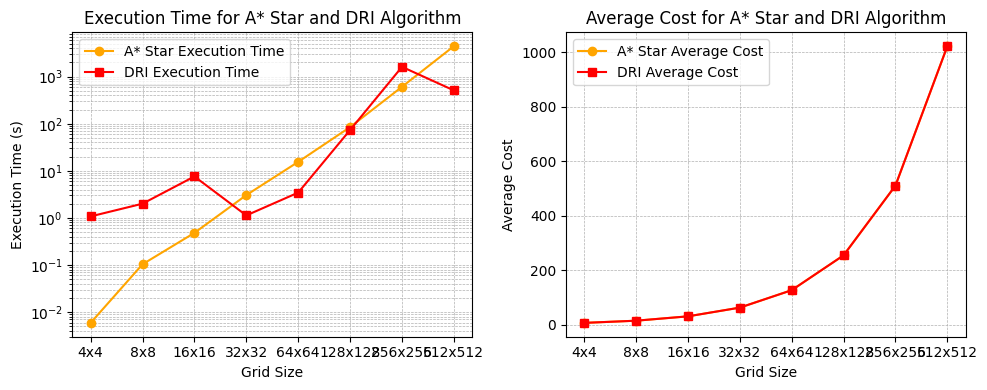

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Grid sizes
grid_sizes = ['4x4', '8x8', '16x16', '32x32', '64x64', '128x128', '256x256', '512x512']
x = np.arange(len(grid_sizes))

# A* Star Execution Time and Average Cost
astar_exec_time = [0.0059, 0.1036, 0.4807, 3.0483, 15.4763, 84.7217, 607.4264, 4431.0381]
astar_avg_cost = [6, 14, 30, 62, 126, 254, 510, 1022]

# DRI Algorithm Execution Time and Average Cost
dri_exec_time = [1.0762, 2.0027, 7.5812, 1.1285, 3.4424, 73.4992, 1612.1028, 510]
dri_avg_cost = [6, 14, 30, 62, 126, 254, 510, 1022]

# Plotting Execution Time
plt.figure(figsize=(10, 4))  # Set smaller figure size

# Execution Time Plot
plt.subplot(1, 2, 1)
plt.plot(grid_sizes, astar_exec_time, marker='o', label='A* Star Execution Time', color='orange')
plt.plot(grid_sizes, dri_exec_time, marker='s', label='DRI Execution Time', color='red')
plt.yscale('log')  # Use logarithmic scale for better visualization
plt.xlabel('Grid Size')
plt.ylabel('Execution Time (s)')
plt.title('Execution Time for A* Star and DRI Algorithm')
plt.legend()
plt.grid(visible=True, which='both', linestyle='--', linewidth=0.5)

# Average Cost Plot
plt.subplot(1, 2, 2)
plt.plot(grid_sizes, astar_avg_cost, marker='o', label='A* Star Average Cost', color='orange')
plt.plot(grid_sizes, dri_avg_cost, marker='s', label='DRI Average Cost', color='red')
plt.xlabel('Grid Size')
plt.ylabel('Average Cost')
plt.title('Average Cost for A* Star and DRI Algorithm')
plt.legend()
plt.grid(visible=True, linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.show()


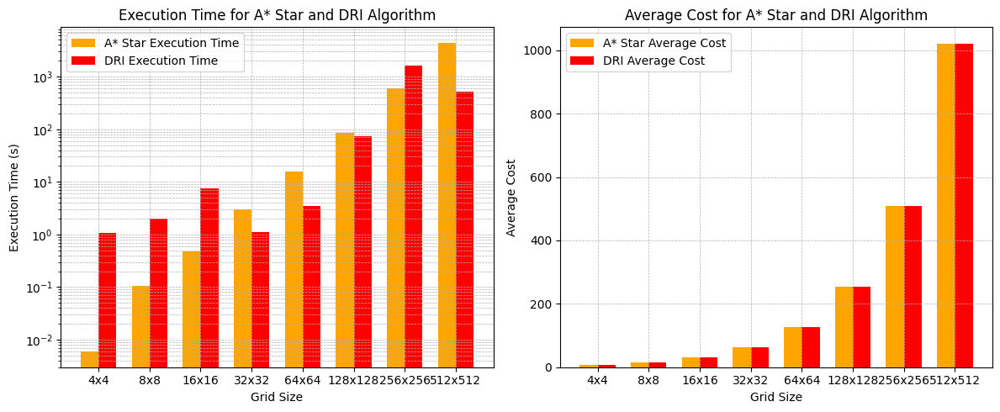

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Grid sizes
grid_sizes = ['4x4', '8x8', '16x16', '32x32', '64x64', '128x128', '256x256', '512x512']
x = np.arange(len(grid_sizes))  # X locations for each group

# A* Star Execution Time and Average Cost
astar_exec_time = [0.0059, 0.1036, 0.4807, 3.0483, 15.4763, 84.7217, 607.4264, 4431.0381]
astar_avg_cost = [6, 14, 30, 62, 126, 254, 510, 1022]

# DRI Algorithm Execution Time and Average Cost
dri_exec_time = [1.0762, 2.0027, 7.5812, 1.1285, 3.4424, 73.4992, 1612.1028, 510]
dri_avg_cost = [6, 14, 30, 62, 126, 254, 510, 1022]

# Width of each bar
bar_width = 0.35

# Plotting Execution Time
plt.figure(figsize=(12, 5))

# Execution Time Bar Plot
plt.subplot(1, 2, 1)
plt.bar(x - bar_width/2, astar_exec_time, width=bar_width, label='A* Star Execution Time', color='orange')
plt.bar(x + bar_width/2, dri_exec_time, width=bar_width, label='DRI Execution Time', color='red')
plt.yscale('log')  # Use logarithmic scale for better visualization
plt.xlabel('Grid Size')
plt.ylabel('Execution Time (s)')
plt.title('Execution Time for A* Star and DRI Algorithm')
plt.xticks(ticks=x, labels=grid_sizes)
plt.legend()
plt.grid(visible=True, which='both', linestyle='--', linewidth=0.5)

# Average Cost Bar Plot
plt.subplot(1, 2, 2)
plt.bar(x - bar_width/2, astar_avg_cost, width=bar_width, label='A* Star Average Cost', color='orange')
plt.bar(x + bar_width/2, dri_avg_cost, width=bar_width, label='DRI Average Cost', color='red')
plt.xlabel('Grid Size')
plt.ylabel('Average Cost')
plt.title('Average Cost for A* Star and DRI Algorithm')
plt.xticks(ticks=x, labels=grid_sizes)
plt.legend()
plt.grid(visible=True, linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.show()
